<a href="https://colab.research.google.com/github/AndSiq97/COVID-19-Healthy-Diet/blob/master/Food_Supply_(in_kg)_Quantity_COVID_19_Health_Diet_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib 
import seaborn as sns
import os
%matplotlib inline
import matplotlib.style as style

In [2]:
# Uncomment this cell, Run this, comment cell, restart runtime and run everything else
# !pip install --upgrade matplotlib

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

os.environ['KAGGLE_CONFIG_DIR'] = "/content/gdrive/My Drive/Kaggle"
# /content/gdrive/My Drive/Kaggle is the path where kaggle.json is present in the Google Drive

#changing the working directory
%cd /content/gdrive/My Drive/Kaggle
#Check the present working directory using pwd command

Mounted at /content/gdrive
/content/gdrive/My Drive/Kaggle


Load Datasets

In [4]:
# Reading some csv files
food_supply_quantity_kg_data = pd.read_csv("/content/gdrive/MyDrive/Food_Supply_Quantity_kg_Data.csv")
supply_food_descriptions_data = pd.read_csv("/content/gdrive/MyDrive/Supply_Food_Data_Descriptions.csv")

Food Supply Descriptions Data

In [5]:
# Checking first 5 rows of Supply Food Descriptions dataframe
supply_food_descriptions_data.head()

,Categories,Items
0,Alcoholic Beverages,"Alcohol, Non-Food; Beer; Beverages, Alcoholic;..."
1,Animal fats,"Butter, Ghee; Cream; Fats, Animals, Raw; Fish,..."
2,Animal Products,"Aquatic Animals, Others; Aquatic Plants; Bovin..."
3,"Aquatic Products, Other","Aquatic Animals, Others; Aquatic Plants; Meat,..."
4,Cereals - Excluding Beer,"Barley and products; Cereals, Other; Maize and..."


Food Supply Quantity (in kg) Data

In [6]:
# Checking first 5 rows of Food Supply Quantity (in kg) dataframe
food_supply_quantity_kg_data.head()

,Country,Alcoholic Beverages,Animal fats,Animal Products,"Aquatic Products, Other",Cereals - Excluding Beer,Eggs,"Fish, Seafood",Fruits - Excluding Wine,Meat,Milk - Excluding Butter,Miscellaneous,Offals,Oilcrops,Pulses,Spices,Starchy Roots,Stimulants,Sugar & Sweeteners,Sugar Crops,Treenuts,Vegetable Oils,Vegetables,Vegetal Products,Obesity,Undernourished,Confirmed,Deaths,Recovered,Active,Population,Unit (all except Population)
0,Afghanistan,0.0014,0.1973,9.4341,0.0,24.8097,0.2099,0.0350,5.3495,1.2020,7.5828,0.0728,0.2057,0.0700,0.2953,0.0574,0.8802,0.3078,1.3489,0.0,0.0770,0.5345,6.7642,40.5645,4.5,29.8,0.005707,0.000168,0.000683,0.004855,38042000.0,%
1,Albania,1.6719,0.1357,18.7684,0.0,5.7817,0.5815,0.2126,6.7861,1.8845,15.7213,0.1123,0.2324,0.9377,0.2380,0.0008,1.8096,0.1055,1.5367,0.0,0.1515,0.3261,11.7753,31.2304,22.3,6.2,0.027047,0.001085,0.016445,0.009517,2858000.0,%
2,Algeria,0.2711,0.0282,9.6334,0.0,13.6816,0.5277,0.2416,6.3801,1.1305,7.6189,0.1671,0.0870,0.3493,0.4783,0.0557,4.1340,0.2216,1.8342,0.0,0.1152,1.0310,11.6484,40.3651,26.6,3.9,0.009229,0.001037,0.004099,0.004094,43406000.0,%
3,Angola,5.8087,0.0560,4.9278,0.0,9.1085,0.0587,1.7707,6.0005,2.0571,0.8311,0.1165,0.1550,0.4186,0.6507,0.0009,18.1102,0.0508,1.8495,0.0,0.0061,0.6463,2.3041,45.0722,6.8,25,0.000086,0.000006,0.000022,0.000057,31427000.0,%
4,Antigua and Barbuda,3.5764,0.0087,16.6613,0.0,5.9960,0.2274,4.1489,10.7451,5.6888,6.3663,0.7139,0.2219,0.2172,0.1840,0.1524,1.4522,0.1564,3.8749,0.0,0.0253,0.8102,5.4495,33.3233,19.1,NaN,0.024742,0.003093,0.011340,0.010309,97000.0,%


In [7]:
# Names of Columns in DataFrame
food_supply_quantity_kg_data.columns

Index(['Country', 'Alcoholic Beverages', 'Animal fats', 'Animal Products',
       'Aquatic Products, Other', 'Cereals - Excluding Beer', 'Eggs',
       'Fish, Seafood', 'Fruits - Excluding Wine', 'Meat',
       'Milk - Excluding Butter', 'Miscellaneous', 'Offals', 'Oilcrops',
       'Pulses', 'Spices', 'Starchy Roots', 'Stimulants', 'Sugar & Sweeteners',
       'Sugar Crops', 'Treenuts', 'Vegetable Oils', 'Vegetables',
       'Vegetal Products', 'Obesity', 'Undernourished', 'Confirmed', 'Deaths',
       'Recovered', 'Active', 'Population', 'Unit (all except Population)'],
      dtype='object')

In [8]:
# Checking size/shape of DataFrame
food_supply_quantity_kg_data.shape

(170, 32)

In [9]:
# Data Info
food_supply_quantity_kg_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170 entries, 0 to 169
Data columns (total 32 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Country                       170 non-null    object 
 1   Alcoholic Beverages           170 non-null    float64
 2   Animal fats                   170 non-null    float64
 3   Animal Products               170 non-null    float64
 4   Aquatic Products, Other       170 non-null    float64
 5   Cereals - Excluding Beer      170 non-null    float64
 6   Eggs                          170 non-null    float64
 7   Fish, Seafood                 170 non-null    float64
 8   Fruits - Excluding Wine       170 non-null    float64
 9   Meat                          170 non-null    float64
 10  Milk - Excluding Butter       170 non-null    float64
 11  Miscellaneous                 170 non-null    float64
 12  Offals                        170 non-null    float64
 13  Oilcr

In [10]:
# Weird that Undernourished Rate (as %) is not a float type so we'll change that
import re
import random

# random number for Undernourished values < 2.5 to reduce bias 
def random_number(integer):
  if integer == 2.5:
    return random.uniform(0.0, 2.5)
  return integer

food_supply_quantity_kg_data['Undernourished'] = food_supply_quantity_kg_data['Undernourished'].apply(lambda string: re.compile(r'[^\d.]+').sub('', str(string))) 
food_supply_quantity_kg_data['Undernourished'] = pd.to_numeric(food_supply_quantity_kg_data['Undernourished'], errors='coerce')
food_supply_quantity_kg_data['Undernourished'] = food_supply_quantity_kg_data['Undernourished'].apply(lambda integer: random_number(integer)) 

In [12]:
# Basic statistics to describe DataFrame
food_supply_quantity_kg_data.describe()

,Alcoholic Beverages,Animal fats,Animal Products,"Aquatic Products, Other",Cereals - Excluding Beer,Eggs,"Fish, Seafood",Fruits - Excluding Wine,Meat,Milk - Excluding Butter,Miscellaneous,Offals,Oilcrops,Pulses,Spices,Starchy Roots,Stimulants,Sugar & Sweeteners,Sugar Crops,Treenuts,Vegetable Oils,Vegetables,Vegetal Products,Obesity,Undernourished,Confirmed,Deaths,Recovered,Active,Population
count,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,167.000000,163.000000,160.000000,160.000000,160.000000,160.000000,1.700000e+02
mean,3.022971,0.221064,12.181871,0.013994,11.800347,0.470570,1.387195,5.621405,3.375934,6.519776,0.443122,0.193435,0.818120,0.537131,0.091011,5.335371,0.201946,2.799115,0.095846,0.117474,0.851554,6.085912,37.814834,18.707784,10.881558,0.058884,0.003343,0.025432,0.030158,4.408395e+07
std,2.382243,0.278304,5.852635,0.129382,5.824870,0.331209,1.257382,3.152849,1.762911,5.020379,0.685727,0.159634,1.772273,0.601111,0.121898,5.571355,0.189239,1.545951,0.379936,0.146143,0.445335,3.560148,5.852943,9.633557,12.167551,0.104288,0.009448,0.067907,0.052592,1.556265e+08
min,0.000000,0.001000,1.739100,0.000000,3.401400,0.023900,0.034200,0.659600,0.356000,0.096300,0.000000,0.000000,0.009800,0.000000,0.000000,0.679600,0.004200,0.366600,0.000000,0.000000,0.091500,0.857000,23.113200,2.100000,0.033298,0.000021,0.000000,0.000000,0.000010,5.300000e+04
25%,0.895625,0.040225,7.236850,0.000000,7.226850,0.187575,0.557100,3.541950,1.891475,2.172250,0.032325,0.105050,0.134075,0.129650,0.016500,2.023825,0.083325,1.721025,0.000000,0.020750,0.507700,3.616500,33.552775,8.500000,2.191157,0.003070,0.000055,0.000726,0.001078,2.822750e+06
50%,2.866150,0.116850,12.097550,0.000000,10.142750,0.460150,1.029250,5.021250,3.424750,5.336900,0.196850,0.166800,0.326650,0.300800,0.042550,3.108650,0.159450,2.601650,0.000000,0.079950,0.774450,5.028100,37.900700,21.200000,6.800000,0.013152,0.000336,0.003517,0.006543,1.014600e+07
75%,4.710950,0.253900,16.444125,0.001400,15.148950,0.644150,1.821275,6.827750,4.422450,10.407100,0.583625,0.228575,0.691675,0.734900,0.123150,5.745875,0.261800,3.782150,0.000000,0.148650,1.070900,7.801650,42.762775,25.700000,14.600000,0.068110,0.001683,0.018089,0.032337,3.169250e+07
max,15.370600,1.355900,26.886500,1.679400,29.804500,1.696000,8.795900,19.302800,8.170000,20.837800,3.663400,1.225600,12.176300,3.483800,0.662600,27.712800,1.282300,9.725900,3.067700,0.756900,2.202600,19.299500,48.258500,45.600000,59.600000,0.610323,0.066277,0.518226,0.266797,1.398030e+09


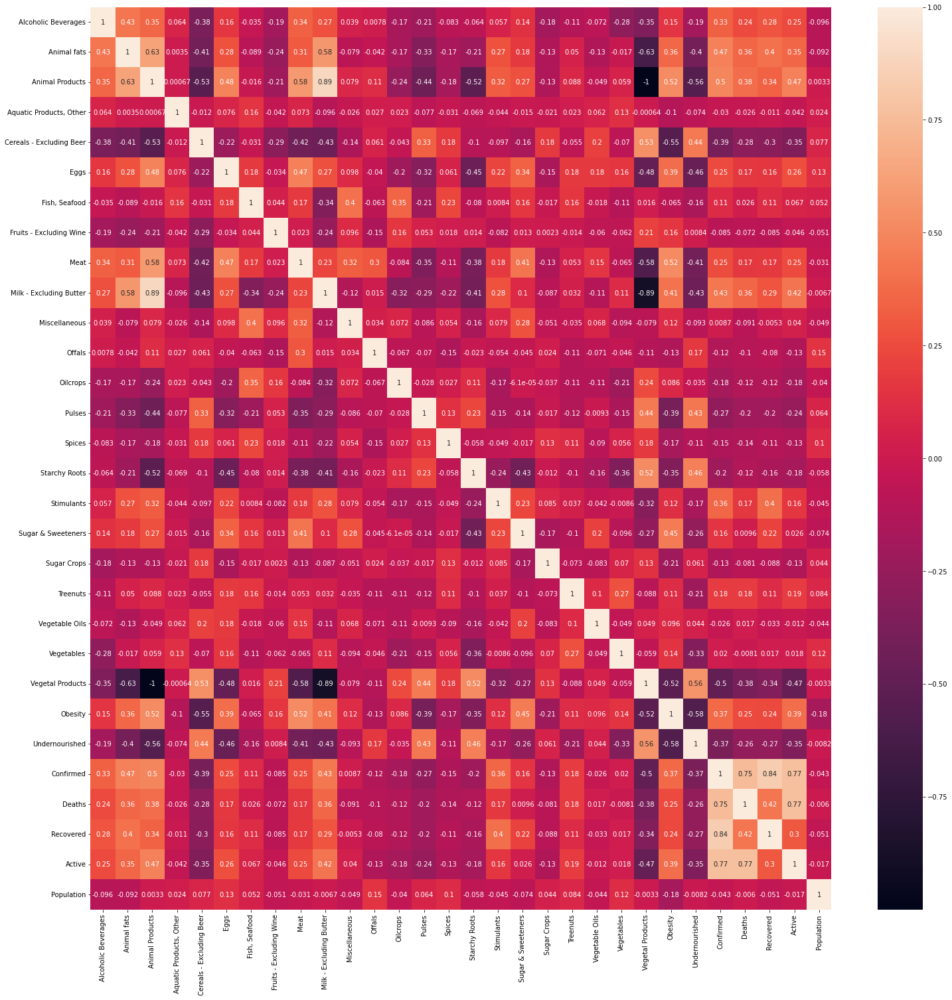

In [13]:
# Correlation Matrix (Works Only for Regression Variables)
fig, ax = plt.subplots(figsize=(25,25)) 
corrMatrix = food_supply_quantity_kg_data.corr()
sns.heatmap(corrMatrix, annot=True, ax=ax)
plt.show()

In [14]:
# List of ALL Health Diet Intakes 
health_diet_intakes = ['Alcoholic Beverages', 'Animal Products', 'Animal fats', 'Aquatic Products, Other', 'Cereals - Excluding Beer', 'Eggs', 'Fish, Seafood', 'Fruits - Excluding Wine', 
                       'Meat', 'Miscellaneous', 'Milk - Excluding Butter', 'Offals', 'Oilcrops', 'Pulses', 'Spices', 'Starchy Roots', 'Stimulants', 'Sugar Crops', 'Sugar & Sweeteners',
                       'Treenuts', 'Vegetal Products', 'Vegetable Oils', 'Vegetables']

Relationship Between ALL Health Diet Food Intakes (in kg) Percentage and Obesity Percentage

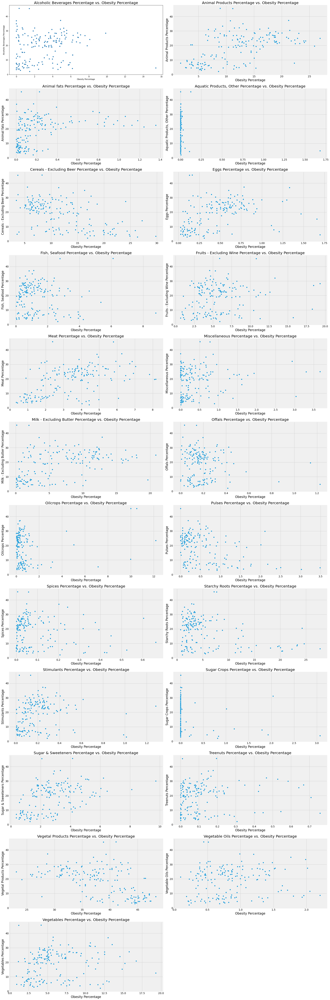

In [15]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Obesity', 
            data = food_supply_quantity_kg_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Obesity Percentage"
  x_title = "Obesity Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Food Intakes (in kg) Percentage and Undernourished Percentage

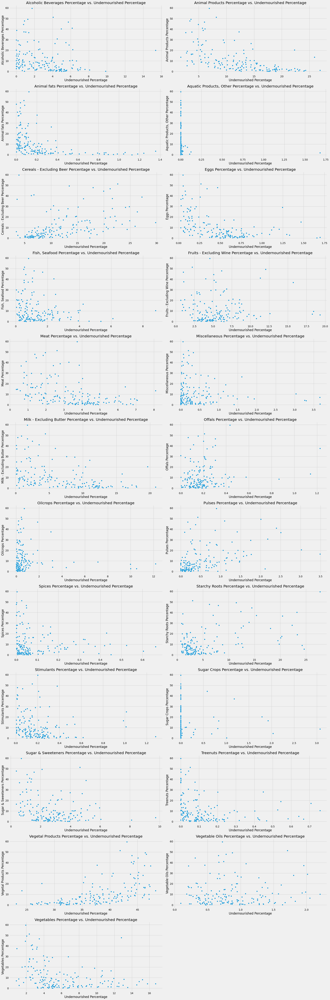

In [16]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Undernourished', 
            data = food_supply_quantity_kg_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Undernourished Percentage"
  x_title = "Undernourished Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Food Intakes (in kg) Percentage and Confirmed Cases of COVID-19 Percentage

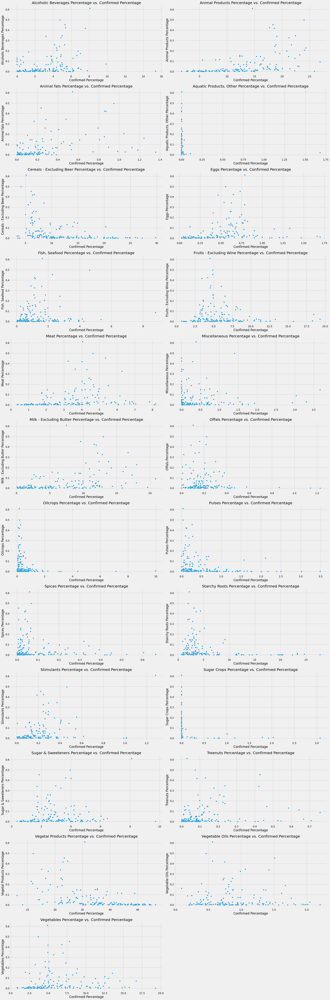

In [17]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Confirmed', 
            data = food_supply_quantity_kg_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Confirmed Percentage"
  x_title = "Confirmed Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Food Intakes (in kg) Percentage and Death from COVID-19 Percentage

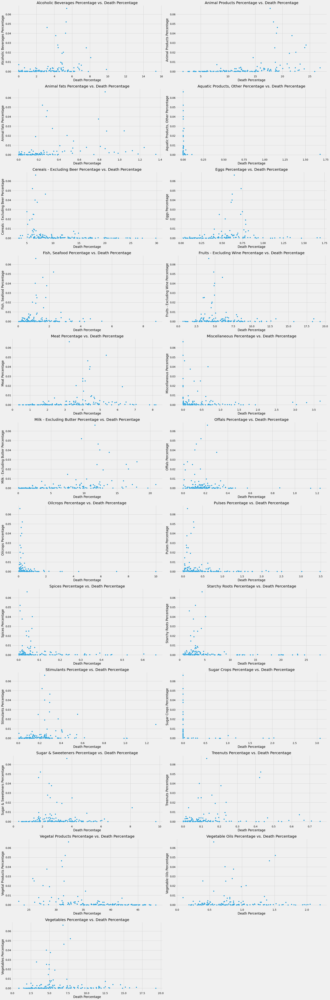

In [18]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Deaths', 
            data = food_supply_quantity_kg_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Death Percentage"
  x_title = "Death Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Food Intakes (in kg) Percentage and Recovery from COVID-19 Percentage

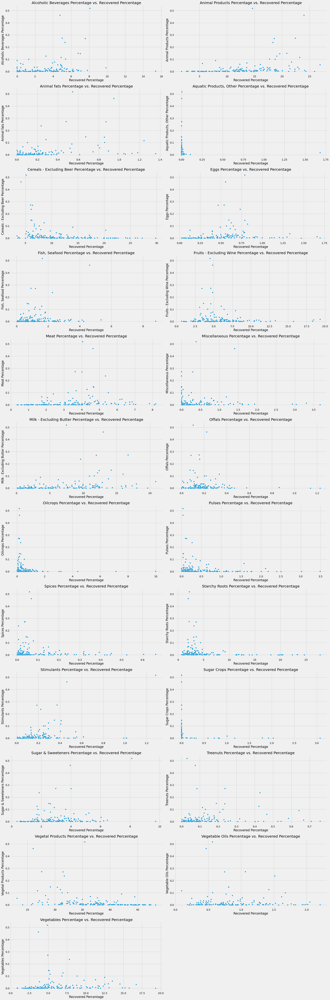

In [19]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Recovered', 
            data = food_supply_quantity_kg_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Recovered Percentage"
  x_title = "Recovered Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Food Intakes (in kg) Percentage and Active Cases of COVID-19 Percentage

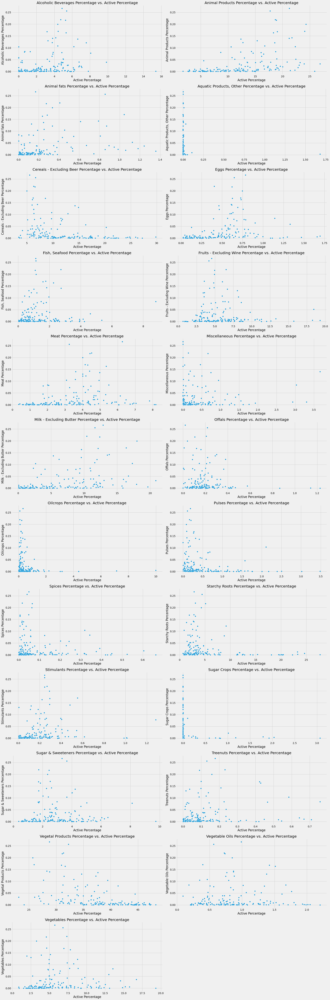

In [20]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Active', 
            data = food_supply_quantity_kg_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Active Percentage"
  x_title = "Active Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Obesity Percentages and ALL of Confirmed, Death, Recovered, and Active Cases of COVID-19 Percentages

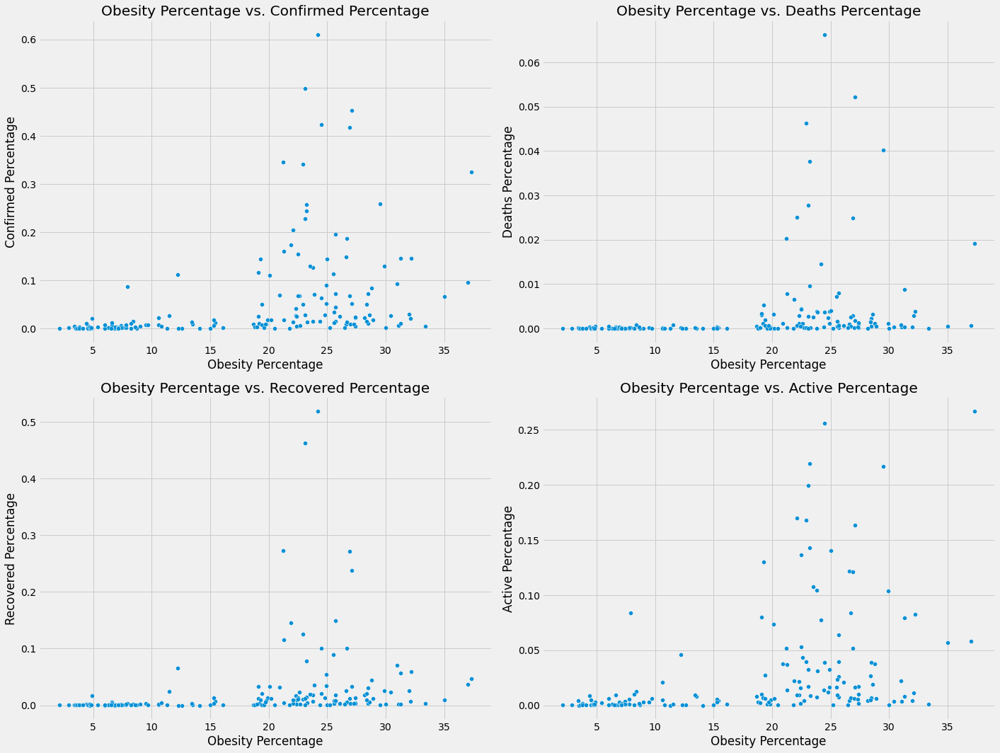

In [21]:
a = 2  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(20,15))
for target in ['Confirmed', 'Deaths', 'Recovered', 'Active']:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = 'Obesity', y = target, 
            data = food_supply_quantity_kg_data)
  style.use('fivethirtyeight')
  title = "Obesity Percentage vs. " + target + " Percentage"
  x_title = "Obesity Percentage"
  y_title = target + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Undernourished Percentages and ALL of Confirmed, Death, Recovered, and Active Cases of COVID-19 Percentages

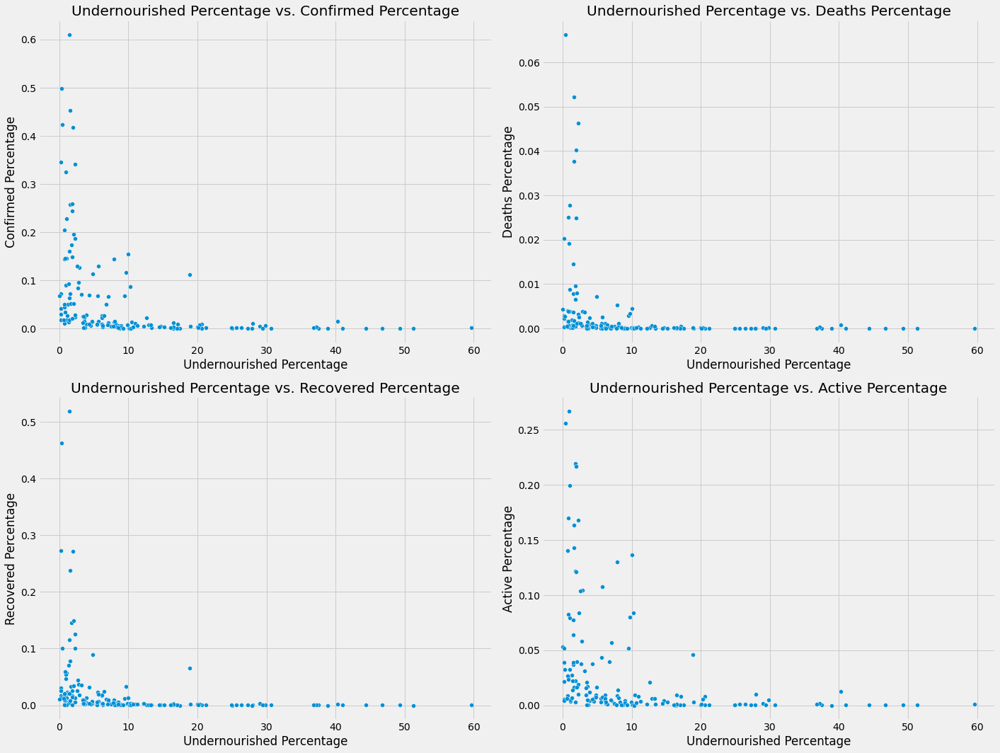

In [22]:
a = 2  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(20,15))
for target in ['Confirmed', 'Deaths', 'Recovered', 'Active']:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = 'Undernourished', y = target, 
            data = food_supply_quantity_kg_data)
  style.use('fivethirtyeight')
  title = "Undernourished Percentage vs. " + target + " Percentage"
  x_title = "Undernourished Percentage"
  y_title = target + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Confirmed Cases of COVID-19 Percentages Between Countries

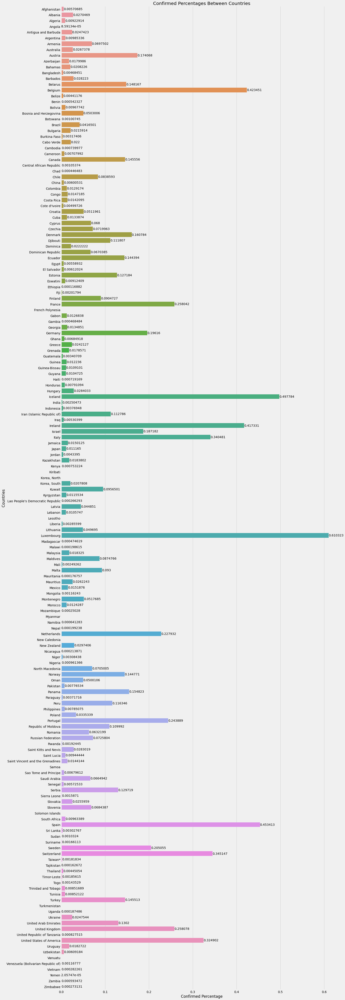

In [23]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Confirmed', y = 'Country', data = food_supply_quantity_kg_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Confirmed Percentages Between Countries"
plt.title(title)
plt.xlabel("Confirmed Percentage")
plt.ylabel("Countries")
plt.show()

Death from COVID-19 Percentages Between Countries

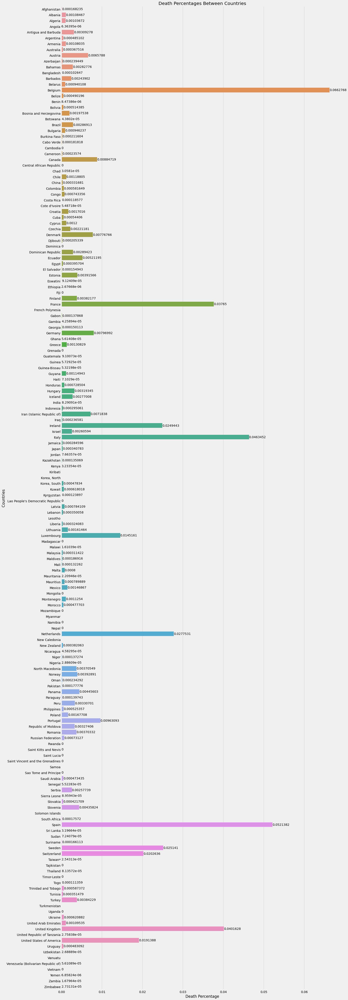

In [24]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Deaths', y = 'Country', data = food_supply_quantity_kg_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Death Percentages Between Countries"
plt.title(title)
plt.xlabel("Death Percentage")
plt.ylabel("Countries")
plt.show()

Recovered from COVID-19 Percentages Between Countries

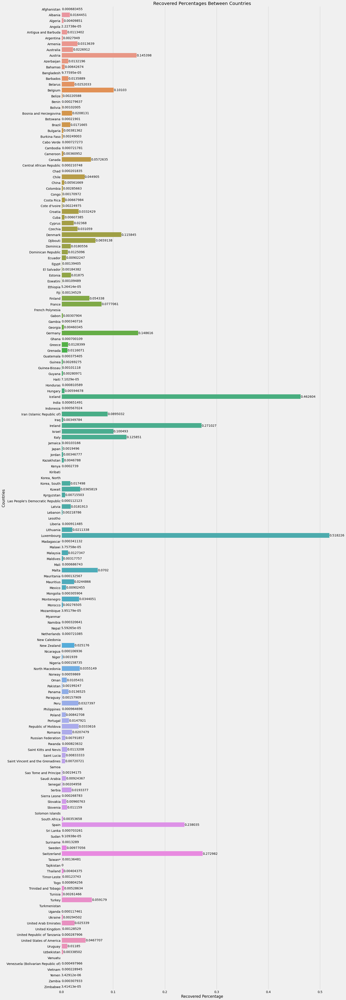

In [25]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Recovered', y = 'Country', data = food_supply_quantity_kg_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Recovered Percentages Between Countries"
plt.title(title)
plt.xlabel("Recovered Percentage")
plt.ylabel("Countries")
plt.show()

Active Cases of COVID-19 Percentages Between Countries

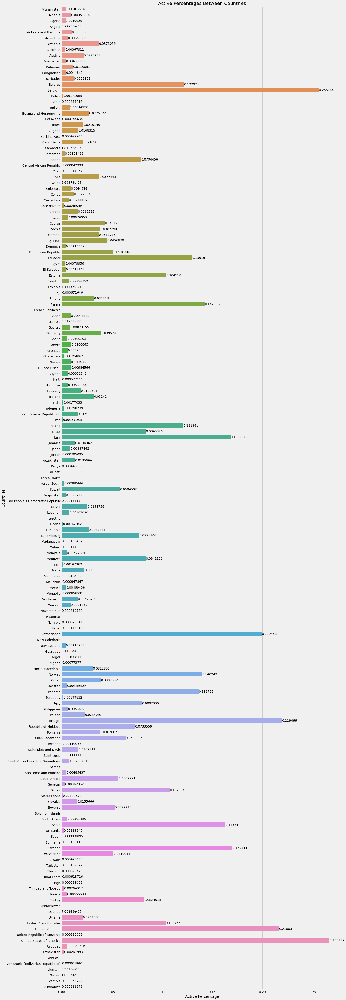

In [26]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Active', y = 'Country', data = food_supply_quantity_kg_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Active Percentages Between Countries"
plt.title(title)
plt.xlabel("Active Percentage")
plt.ylabel("Countries")
plt.show()

ALL Health Diet Food Intakes (in kg) Percentages Between Countries

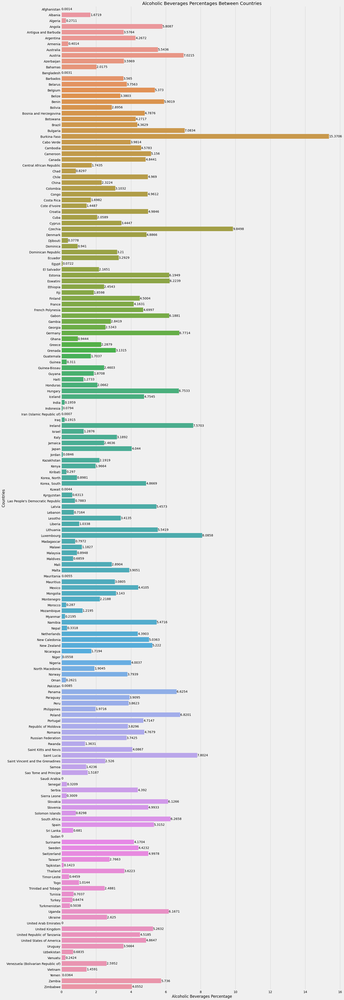

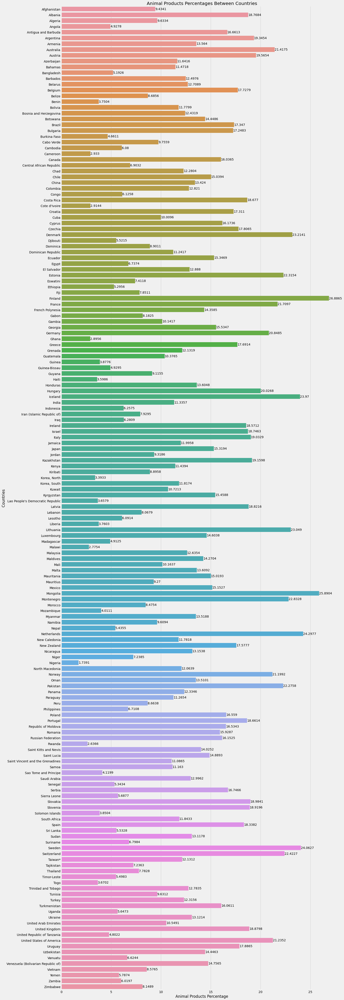

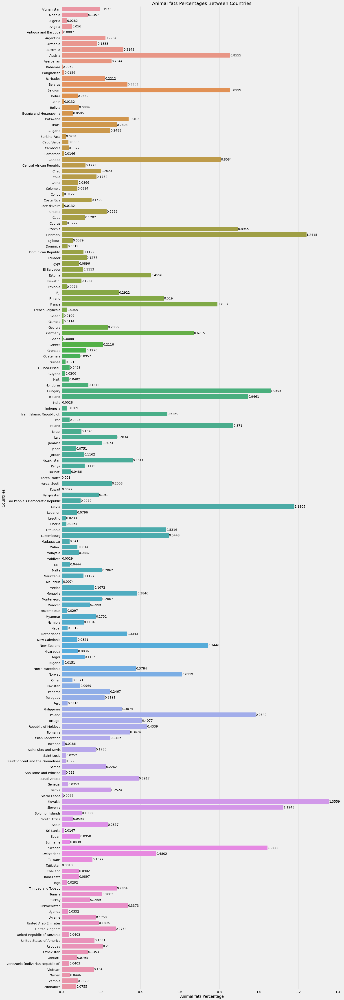

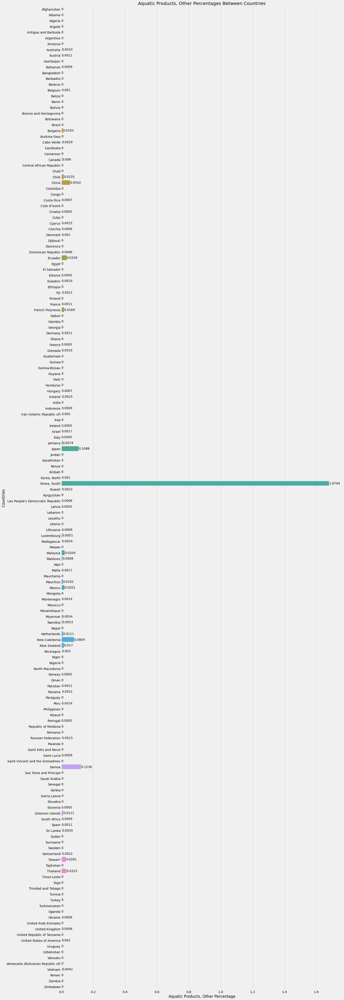

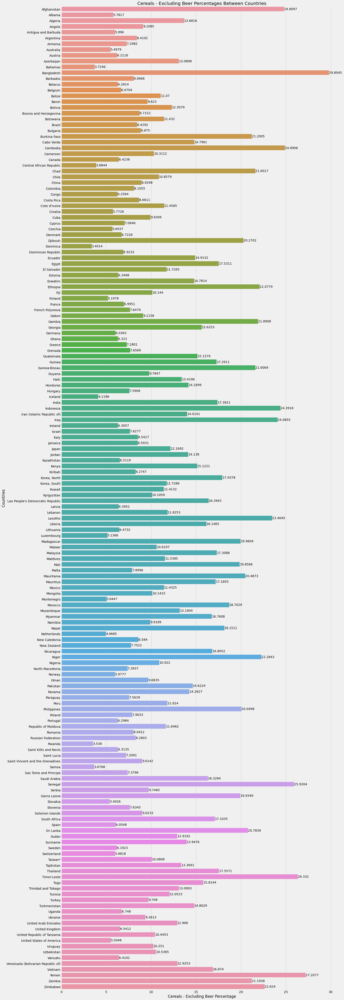

...

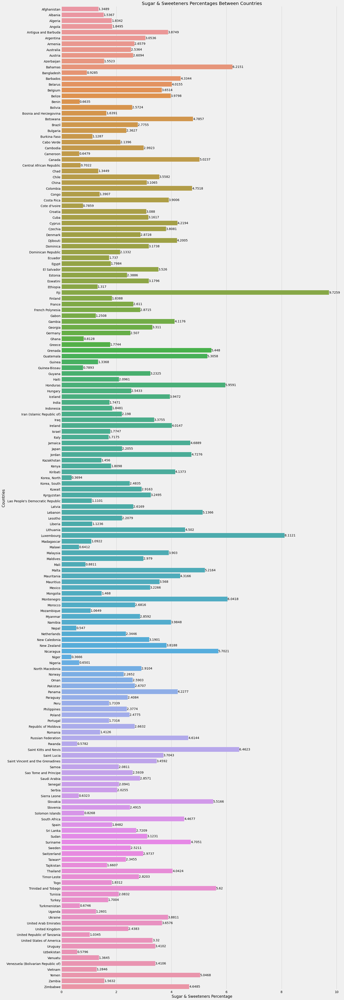

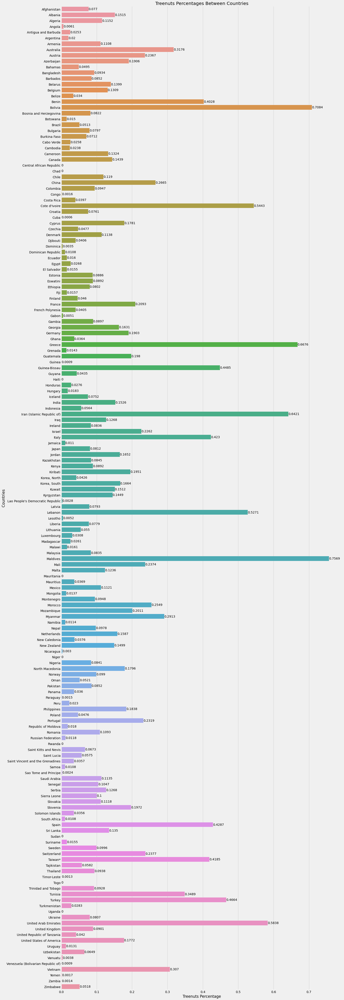

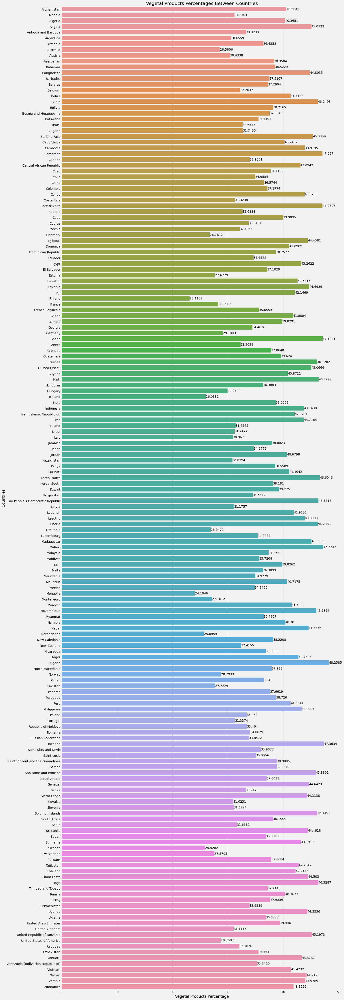

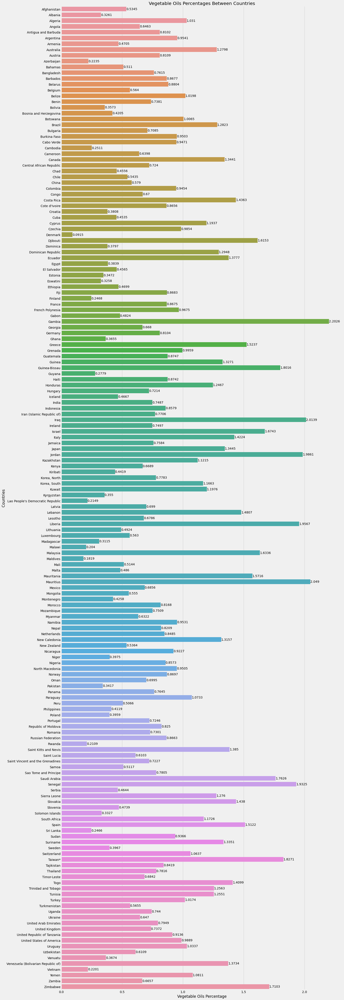

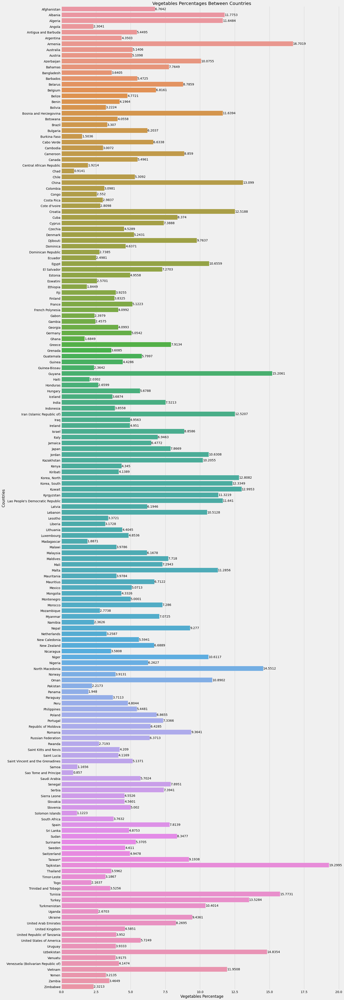

In [27]:
for intake in health_diet_intakes:
  fig, ax = plt.subplots(figsize=(20, 75))
  sns.barplot(x = intake, y = 'Country', data = food_supply_quantity_kg_data, capsize = 0.2, orient = 'h', ax = ax)
  ax.bar_label(ax.containers[-1], label_type='edge')
  style.use('fivethirtyeight')
  title = intake + " Percentages Between Countries"
  x_title = intake + " Percentage"
  y_title = "Countries"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  plt.show()
  print("          ")
  print("          ")